In [1]:
from sklearn.feature_selection import mutual_info_regression
import os
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
import plotly.express as px
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'



from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, confusion_matrix, classification_report)
from sklearn.exceptions import NotFittedError
from sklearn.impute import SimpleImputer
from sklearn.ensemble import (RandomForestClassifier, AdaBoostClassifier, ExtraTreesClassifier,
                              GradientBoostingClassifier, BaggingClassifier, HistGradientBoostingClassifier)
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB, BernoulliNB, MultinomialNB
from sklearn.neighbors import KNeighborsClassifier, RadiusNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.neural_network import MLPClassifier

In [2]:
data= pd.read_csv('/kaggle/input/nasaexoplanets/cleaned_5250.csv')
data

,name,distance,stellar_magnitude,planet_type,discovery_year,mass_multiplier,mass_wrt,radius_multiplier,radius_wrt,orbital_radius,orbital_period,eccentricity,detection_method
0,11 Comae Berenices b,304.0,4.72307,Gas Giant,2007,19.40000,Jupiter,1.080,Jupiter,1.290000,0.892539,0.23,Radial Velocity
1,11 Ursae Minoris b,409.0,5.01300,Gas Giant,2009,14.74000,Jupiter,1.090,Jupiter,1.530000,1.400000,0.08,Radial Velocity
2,14 Andromedae b,246.0,5.23133,Gas Giant,2008,4.80000,Jupiter,1.150,Jupiter,0.830000,0.508693,0.00,Radial Velocity
3,14 Herculis b,58.0,6.61935,Gas Giant,2002,8.13881,Jupiter,1.120,Jupiter,2.773069,4.800000,0.37,Radial Velocity
4,16 Cygni B b,69.0,6.21500,Gas Giant,1996,1.78000,Jupiter,1.200,Jupiter,1.660000,2.200000,0.68,Radial Velocity
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5245,XO-7 b,764.0,10.52100,Gas Giant,2019,0.70900,Jupiter,1.373,Jupiter,0.044210,0.007940,0.04,Transit
5246,YSES 2 b,357.0,10.88500,Gas Giant,2021,6.30000,Jupiter,1.140,Jupiter,115.000000,1176.500000,0.00,Direct Imaging
5247,YZ Ceti b,12.0,12.07400,Terrestrial,2017,0.70000,Earth,0.913,Earth,0.016340,0.005476,0.06,Radial Velocity
5248,YZ Ceti c,12.0,12.07400,Super Earth,2017,1.14000,Earth,1.050,Earth,0.021560,0.008487,0.00,Radial Velocity


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5250 entries, 0 to 5249
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               5250 non-null   object 
 1   distance           5233 non-null   float64
 2   stellar_magnitude  5089 non-null   float64
 3   planet_type        5250 non-null   object 
 4   discovery_year     5250 non-null   int64  
 5   mass_multiplier    5227 non-null   float64
 6   mass_wrt           5227 non-null   object 
 7   radius_multiplier  5233 non-null   float64
 8   radius_wrt         5233 non-null   object 
 9   orbital_radius     4961 non-null   float64
 10  orbital_period     5250 non-null   float64
 11  eccentricity       5250 non-null   float64
 12  detection_method   5250 non-null   object 
dtypes: float64(7), int64(1), object(5)
memory usage: 533.3+ KB


In [4]:
round(data.describe().T,2)

,count,mean,std,min,25%,50%,75%,max
distance,5233.0,2167.17,3245.52,4.00,389.00,1371.00,2779.00,27727.00
stellar_magnitude,5089.0,12.68,3.11,0.87,10.94,13.54,15.02,44.61
discovery_year,5250.0,2015.73,4.31,1992.00,2014.00,2016.00,2018.00,2023.00
mass_multiplier,5227.0,6.43,12.97,0.02,1.80,4.17,8.00,752.00
radius_multiplier,5233.0,1.02,0.60,0.20,0.32,1.12,1.41,6.90
orbital_radius,4961.0,6.96,138.67,0.00,0.05,0.10,0.29,7506.00
orbital_period,5250.0,479.15,16804.45,0.00,0.01,0.03,0.14,1101369.90
eccentricity,5250.0,0.06,0.14,-0.52,0.00,0.00,0.06,0.95


In [5]:
data.duplicated().sum()

0

In [6]:
unique_values= {}
for i in data.columns:
    unique_values[i]= data[i].nunique()

pd.DataFrame(unique_values, index=['unique_values']).T    

,unique_values
name,5250
distance,2542
stellar_magnitude,2875
planet_type,5
discovery_year,31
mass_multiplier,1721
mass_wrt,2
radius_multiplier,1032
radius_wrt,2
orbital_radius,2827


In [7]:
catagorical= data.select_dtypes(include=['object']).columns
numerical= data.select_dtypes(include=['int64', "float64"]).columns

print(catagorical)
print("\n")
print(numerical)

Index(['name', 'planet_type', 'mass_wrt', 'radius_wrt', 'detection_method'], dtype='object')


Index(['distance', 'stellar_magnitude', 'discovery_year', 'mass_multiplier',
       'radius_multiplier', 'orbital_radius', 'orbital_period',
       'eccentricity'],
      dtype='object')


In [8]:
# Convert mass and radius to Earth-relative units
data['mass_earth'] = data.apply(lambda x: x['mass_multiplier'] if x['mass_wrt'] == 'Earth' else 317.8 * x['mass_multiplier'], axis=1)
data['radius_earth'] = data.apply(lambda x: x['radius_multiplier'] if x['radius_wrt'] == 'Earth' else 11.2 * x['radius_multiplier'], axis=1)

# Define habitability criteria and create binary flags
def habitability_criteria(data, radius_limits, mass_limits):
    radius_criteria = (data['radius_earth'] > radius_limits[0]) & (data['radius_earth'] <= radius_limits[1])
    mass_criteria = (data['mass_earth'] > mass_limits[0]) & (data['mass_earth'] <= mass_limits[1])
    orbit_criteria = (data['orbital_period'] > 1/3) & (data['orbital_period'] < 3)
    return (radius_criteria & mass_criteria & orbit_criteria).astype(int)

data['is_habitable_consv'] = habitability_criteria(data, (0.5, 1.6), (0.1, 3))
data['is_habitable_optim'] = habitability_criteria(data, (1.6, 2.5), (3, 10))
data['is_habitable_pessi'] = habitability_criteria(data, (2.5, 5), (10, 30))
data['is_habitable_extrem'] = habitability_criteria(data, (5, 10), (30, 100))
# Convert orbital period to days
data['orbital_period_days'] =(data['orbital_period'] * 365.25).apply(np.ceil)

def classify(value, limits, labels):
    if value <= limits[0]:
        return labels[0]
    elif value <= limits[1]:
        return labels[1]
    else:
        return labels[2]

data['distance_group'] =data['distance'].apply(lambda x: classify(x, [1000, 3000], ['Close', 'Medium', 'Far']))
data['stellar_magnitude_group'] = data['stellar_magnitude'].apply(lambda x: classify(x, [5, 10], ['Low', 'Medium', 'High']))
data['mass_group'] =data['mass_multiplier'].apply(lambda x: classify(x, [1, 10], ['Small', 'Medium', 'Large']))
data['radius_group'] = data['radius_multiplier'].apply(lambda x: classify(x, [1, 10], ['Small', 'Medium', 'Large']))
data['orbital_radius_group'] =data['orbital_radius'].apply(lambda x: classify(x, [100, 1000], ['Small', 'Medium', 'Large']))
data['orbital_period_group'] =data['orbital_period'].apply(lambda x: classify(x, [100, 1000], ['Small', 'Medium', 'Large']))
data['eccentricity_group'] =data['eccentricity'].apply(lambda x: classify(x, [0.2, 0.5], ['Small', 'Medium', 'Large']))

In [9]:
data

,name,distance,stellar_magnitude,planet_type,discovery_year,mass_multiplier,mass_wrt,radius_multiplier,radius_wrt,orbital_radius,...,is_habitable_pessi,is_habitable_extrem,orbital_period_days,distance_group,stellar_magnitude_group,mass_group,radius_group,orbital_radius_group,orbital_period_group,eccentricity_group
0,11 Comae Berenices b,304.0,4.72307,Gas Giant,2007,19.40000,Jupiter,1.080,Jupiter,1.290000,...,0,0,327.0,Close,Low,Large,Medium,Small,Small,Medium
1,11 Ursae Minoris b,409.0,5.01300,Gas Giant,2009,14.74000,Jupiter,1.090,Jupiter,1.530000,...,0,0,512.0,Close,Medium,Large,Medium,Small,Small,Small
2,14 Andromedae b,246.0,5.23133,Gas Giant,2008,4.80000,Jupiter,1.150,Jupiter,0.830000,...,0,0,186.0,Close,Medium,Medium,Medium,Small,Small,Small
3,14 Herculis b,58.0,6.61935,Gas Giant,2002,8.13881,Jupiter,1.120,Jupiter,2.773069,...,0,0,1754.0,Close,Medium,Medium,Medium,Small,Small,Medium
4,16 Cygni B b,69.0,6.21500,Gas Giant,1996,1.78000,Jupiter,1.200,Jupiter,1.660000,...,0,0,804.0,Close,Medium,Medium,Medium,Small,Small,Large
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5245,XO-7 b,764.0,10.52100,Gas Giant,2019,0.70900,Jupiter,1.373,Jupiter,0.044210,...,0,0,3.0,Close,High,Small,Medium,Small,Small,Small
5246,YSES 2 b,357.0,10.88500,Gas Giant,2021,6.30000,Jupiter,1.140,Jupiter,115.000000,...,0,0,429717.0,Close,High,Medium,Medium,Medium,Large,Small
5247,YZ Ceti b,12.0,12.07400,Terrestrial,2017,0.70000,Earth,0.913,Earth,0.016340,...,0,0,3.0,Close,High,Small,Small,Small,Small,Small
5248,YZ Ceti c,12.0,12.07400,Super Earth,2017,1.14000,Earth,1.050,Earth,0.021560,...,0,0,4.0,Close,High,Medium,Medium,Small,Small,Small


In [10]:
data['planet_type'].value_counts()

planet_type
Neptune-like    1825
Gas Giant       1630
Super Earth     1595
Terrestrial      195
Unknown            5
Name: count, dtype: int64

In [11]:
data['detection_method'].value_counts()

detection_method
Transit                          3945
Radial Velocity                  1027
Gravitational Microlensing        154
Direct Imaging                     62
Transit Timing Variations          24
Eclipse Timing Variations          17
Orbital Brightness Modulation       9
Pulsar Timing                       7
Astrometry                          2
Pulsation Timing Variations         2
Disk Kinematics                     1
Name: count, dtype: int64

# Profiling

In [12]:
from ydata_profiling import ProfileReport
profile=ProfileReport(data,explorative=True,dark_mode=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

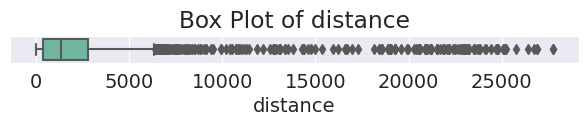

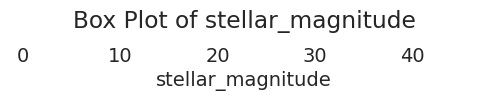

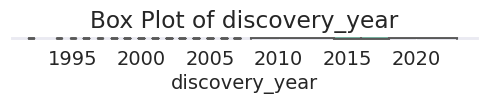

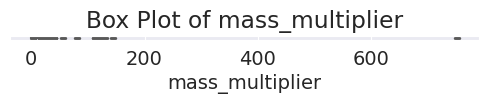

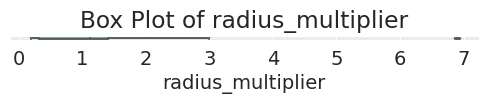

...

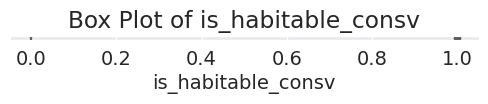

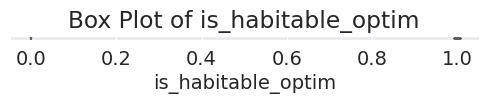

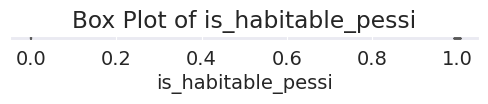

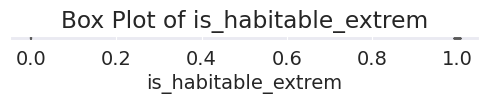

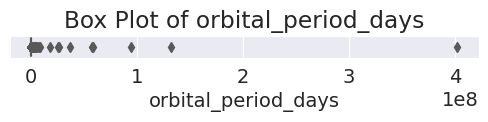

In [13]:
iqr =data.select_dtypes(include=['int64', 'float64']).quantile(0.75) -data.select_dtypes(include=['int64', 'float64']).quantile(0.25)

numerical_columns =data.select_dtypes(include=['int64', 'float64']).columns
num_columns = len(numerical_columns)
num_rows = (num_columns + 1) // 2

plt.figure(figsize=(12, 8))
for i, column in enumerate(numerical_columns, 1):
    plt.subplot(num_rows, 2, i)
    sns.boxplot(x=data[column], hue=iqr[column] , palette='Set2')
    plt.xlabel(column)
    plt.title(f'Box Plot of {column}')
    plt.tight_layout()
    plt.show()

# Univarte Analysis 

Univariate Analysis is a statistical technique used to analyze and summarize the characteristics of a single variable. It focuses on understanding the distribution, central tendency, and dispersion of that variable.

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

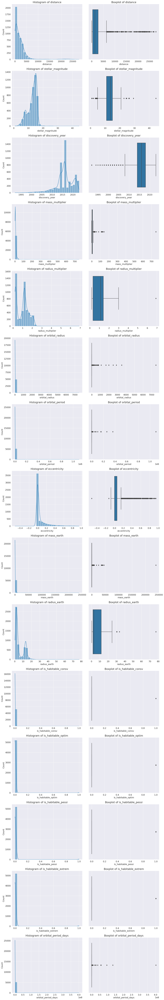

           distance  stellar_magnitude  discovery_year  mass_multiplier  \
count   5233.000000        5089.000000     5250.000000      5227.000000   
mean    2167.168737          12.683738     2015.732190         6.434812   
std     3245.522087           3.107571        4.307336        12.972727   
min        4.000000           0.872000     1992.000000         0.020000   
25%      389.000000          10.939000     2014.000000         1.804000   
50%     1371.000000          13.543000     2016.000000         4.170140   
75%     2779.000000          15.021000     2018.000000         8.000000   
max    27727.000000          44.610000     2023.000000       752.000000   

       radius_multiplier  orbital_radius  orbital_period  eccentricity  \
count        5233.000000     4961.000000    5.250000e+03   5250.000000   
mean            1.015121        6.962942    4.791509e+02      0.063568   
std             0.603479      138.673600    1.680445e+04      0.141424   
min             0.200000    

In [14]:
data.replace([np.inf, -np.inf], np.nan, inplace=True)
numerical_columns =data.select_dtypes(include=['int64', 'float64']).columns

plt.figure(figsize=(15, len(numerical_columns) * 6))

for i, column in enumerate(numerical_columns):
    plt.subplot(len(numerical_columns), 2, 2 * i + 1)
    sns.histplot(data[column], kde=True, bins=30)
    plt.title(f'Histogram of {column}')
    
    plt.subplot(len(numerical_columns), 2, 2 * i + 2)
    sns.boxplot(x=data[column])
    plt.title(f'Boxplot of {column}')
    
plt.tight_layout()
plt.show()

print(data[numerical_columns].describe())

# Bivariate analysis

Bivariate analysis is used to explore the relationship between two variables to understand how they interact with each other. 

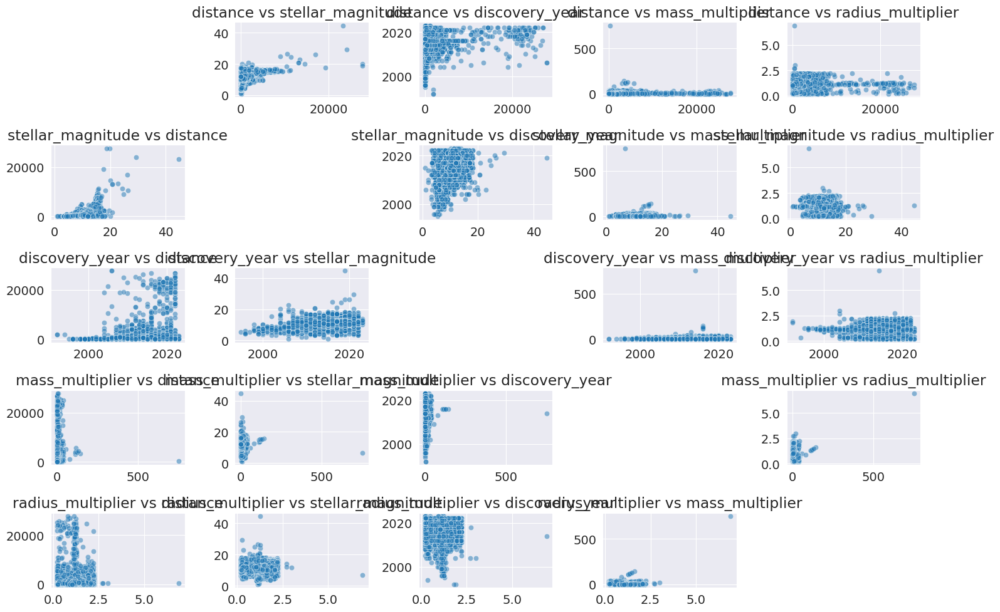

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

subset_columns = numerical_columns[:5]  

plt.figure(figsize=(15, 10))
for i, col1 in enumerate(subset_columns):
    for j, col2 in enumerate(subset_columns):
        if col1 != col2:
            plt.subplot(len(subset_columns), len(subset_columns), i * len(subset_columns) + j + 1)
            sns.scatterplot(data=data, x=col1, y=col2, alpha=0.5)
            plt.title(f'{col1} vs {col2}')
            plt.xlabel('')
            plt.ylabel('')
plt.tight_layout()
plt.show()

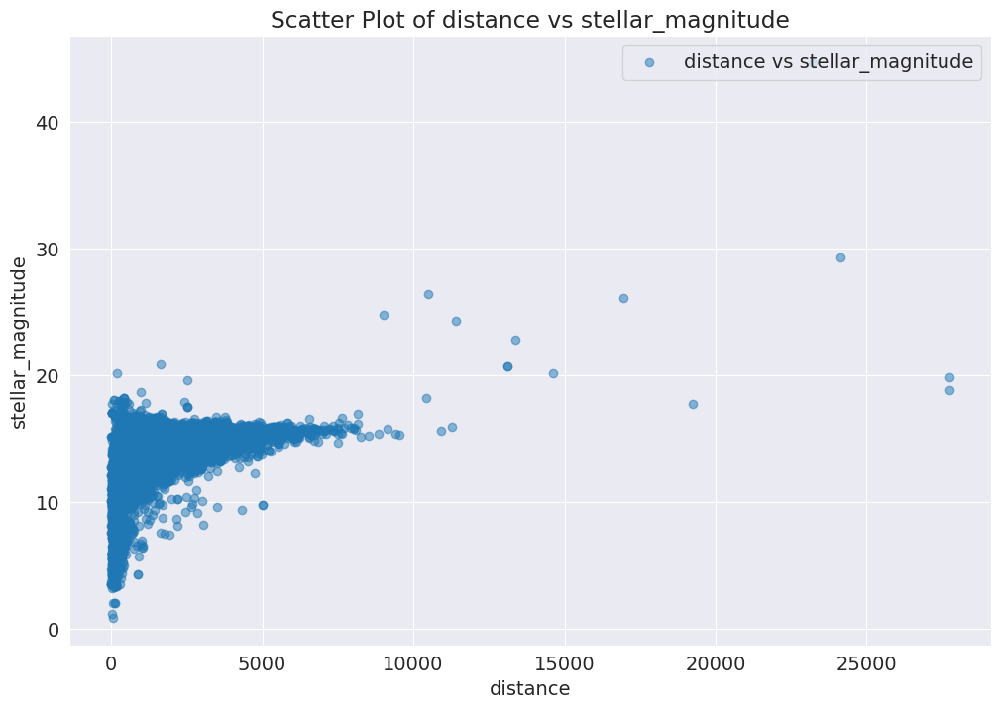

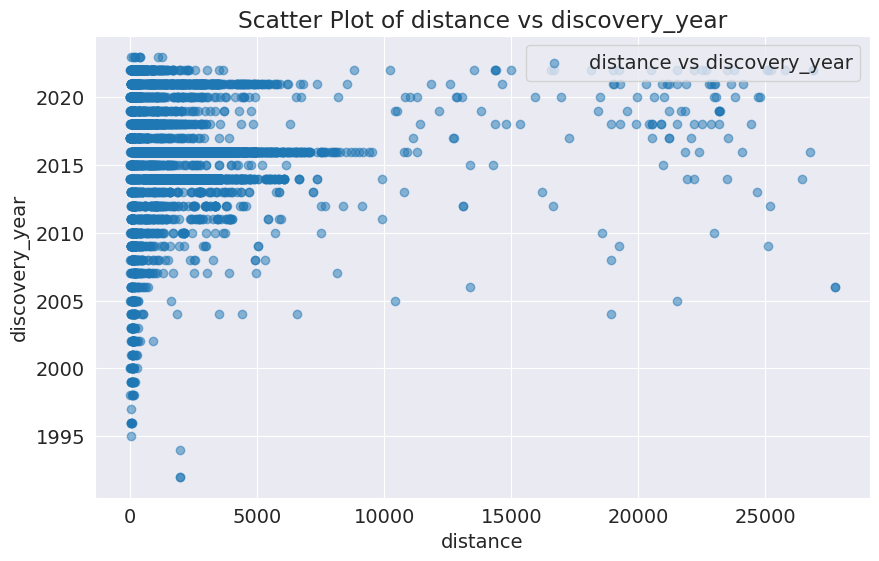

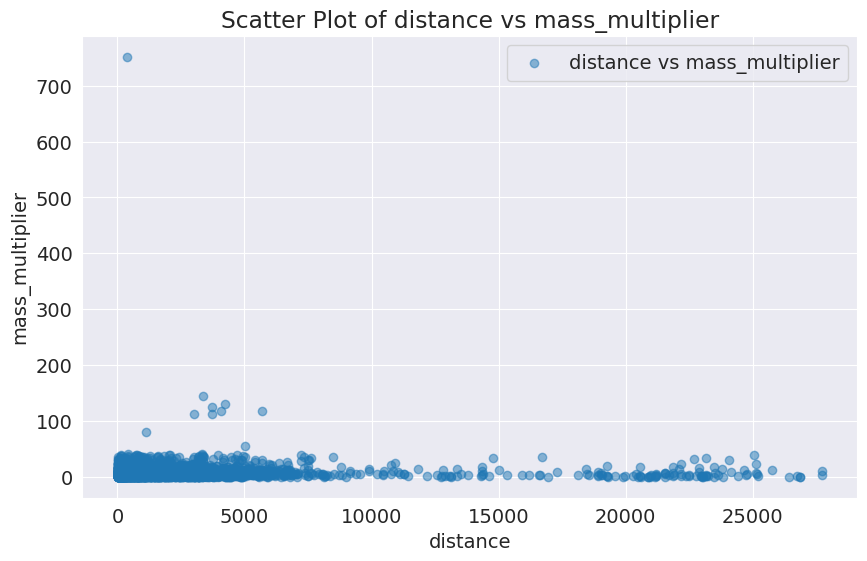

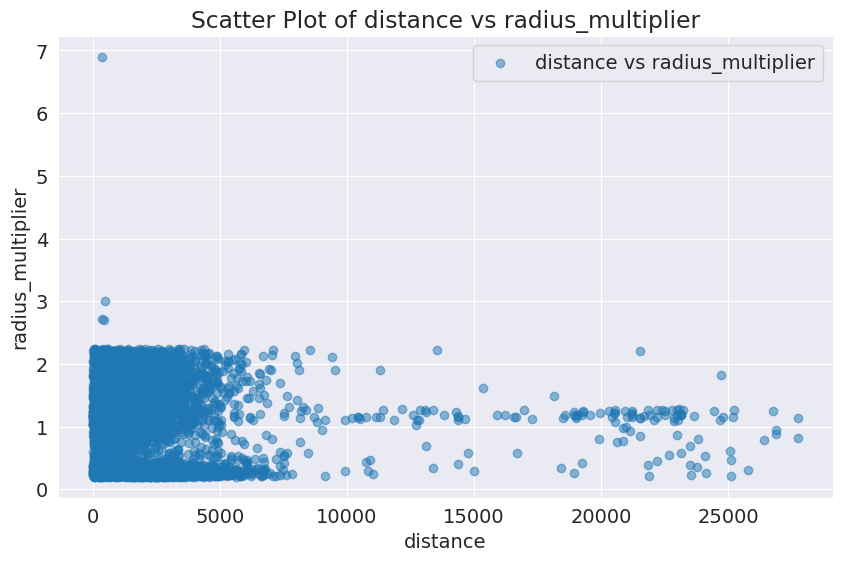

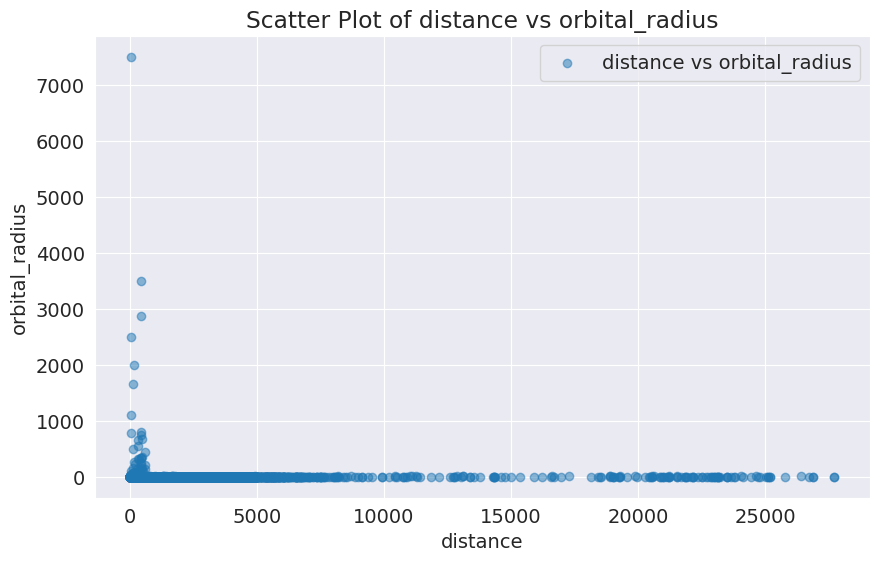

...

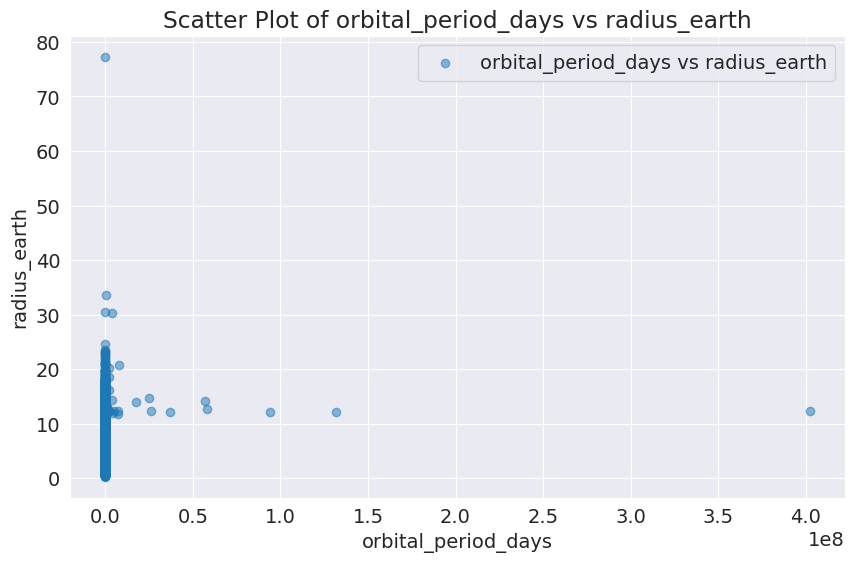

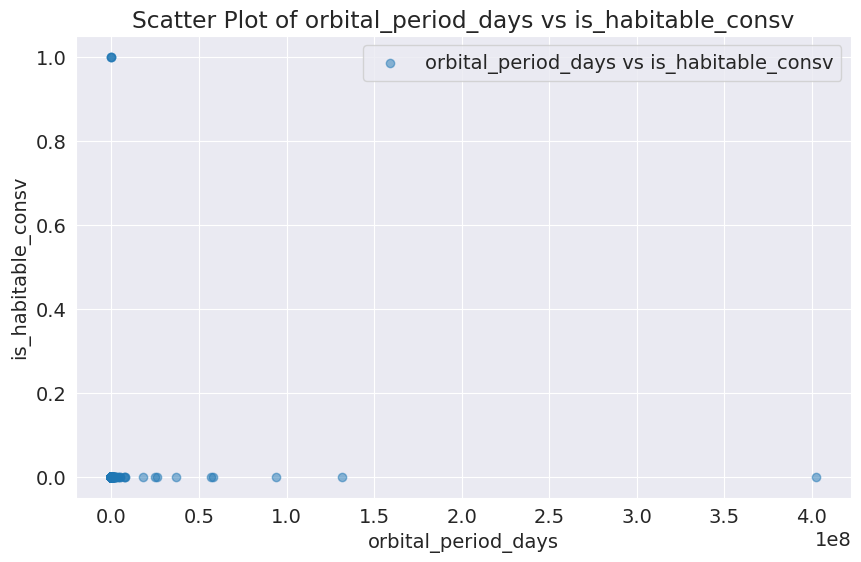

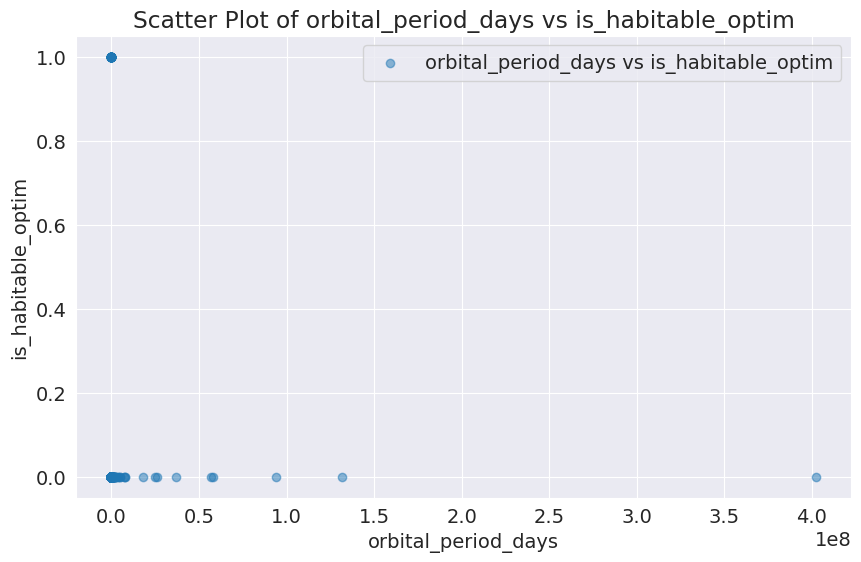

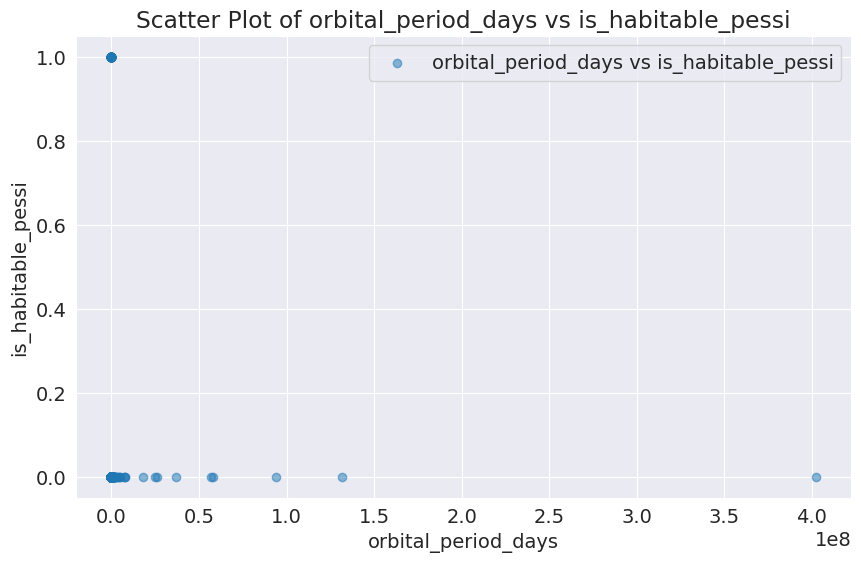

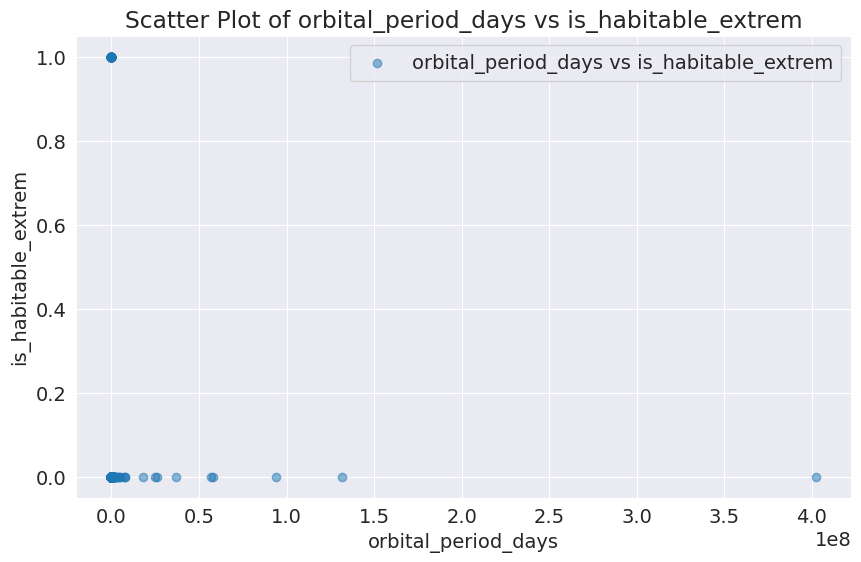

In [16]:
plt.figure(figsize=(12, 8))
for col1 in numerical_columns:
    for col2 in numerical_columns:
        if col1 != col2:
            plt.scatter(data[col1], data[col2], alpha=0.5, label=f'{col1} vs {col2}')
            plt.xlabel(col1)
            plt.ylabel(col2)
            plt.title(f'Scatter Plot of {col1} vs {col2}')
            plt.legend(loc='upper right')
            plt.show()

# Trainiing Model

In [17]:
features = ['radius_earth', 'orbital_period', 'stellar_magnitude']

x= data[features]
y =data['planet_type']

In [18]:
 x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [19]:
pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),  # or 'median', 'most_frequent'
    ('classifier', DecisionTreeClassifier(random_state=42))
])

pipeline.fit(x_train, y_train)
y_pred = pipeline.predict(x_test)
accuracy = accuracy_score(y_test, y_pred)

print("Accuracy:", accuracy)
print("Classification Report:")
print(classification_report(y_test, y_pred, zero_division=0))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.9333333333333333
Classification Report:
              precision    recall  f1-score   support

   Gas Giant       0.98      0.96      0.97       338
Neptune-like       0.92      0.90      0.91       362
 Super Earth       0.91      0.95      0.93       318
 Terrestrial       0.97      0.91      0.94        32
     Unknown       0.00      0.00      0.00         0

    accuracy                           0.93      1050
   macro avg       0.75      0.74      0.75      1050
weighted avg       0.93      0.93      0.93      1050

Confusion Matrix:
[[324  12   0   1   1]
 [  8 326  28   0   0]
 [  0  17 301   0   0]
 [  0   0   3  29   0]
 [  0   0   0   0   0]]


In [20]:
pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),  # or 'median', 'most_frequent'
    ('classifier', ExtraTreesClassifier(criterion='entropy', n_estimators= 100, max_depth= 500, min_samples_split= 2, max_features='log2'))
])

pipeline.fit(x_train, y_train)
y_pred = pipeline.predict(x_test)
accuracy = accuracy_score(y_test, y_pred)

print("Accuracy:", accuracy)
print("Classification Report:")
print(classification_report(y_test, y_pred, zero_division=0))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.9561904761904761
Classification Report:
              precision    recall  f1-score   support

   Gas Giant       0.98      0.96      0.97       338
Neptune-like       0.92      0.97      0.95       362
 Super Earth       0.96      0.95      0.96       318
 Terrestrial       0.96      0.84      0.90        32

    accuracy                           0.96      1050
   macro avg       0.96      0.93      0.94      1050
weighted avg       0.96      0.96      0.96      1050

Confusion Matrix:
[[325  12   0   1]
 [  5 351   6   0]
 [  0  17 301   0]
 [  0   0   5  27]]


# Functional Model

In [21]:
# scaler = StandardScaler()
# x_train_scaled = scaler.fit_transform(x_train)
# x_test_scaled = scaler.transform(x_test)

# label_encoder = LabelEncoder()
# y_train_encoded = label_encoder.fit_transform(y_train)
# y_test_encoded = label_encoder.transform(y_test)

# optimizer = Adam(learning_rate=0.02)

# def build_model(input_dim):
#     inputs = Input(shape=(input_dim,))
#     x = Dense(128, activation='relu')(inputs)
#     x = BatchNormalization()(x)
#     x = Dropout(0.5)(x)
#     x = Dense(64, activation='relu')(x)
#     x = BatchNormalization()(x)
#     x = Dropout(0.5)(x)
#     outputs = Dense(5, activation='softmax')(x) 
    
#     model = Model(inputs=inputs, outputs=outputs)
#     model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
#     return model

# input_dim = x_train_scaled.shape[1]
# model = build_model(input_dim)
# early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
# history = model.fit(x_train_scaled, y_train_encoded, 
#                     epochs=1000, 
#                     batch_size=32, 
#                     validation_split=0.2, 
#                     callbacks=[early_stopping],
#                     verbose=1)

# test_loss, test_accuracy = model.evaluate(x_test_scaled, y_test_encoded, verbose=1)
# print("Test Accuracy:", test_accuracy)

In [22]:
pip install jovian

  Preparing metadata (setup.py) ... - done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.6/68.6 kB 2.6 MB/s eta 0:00:00
  Created wheel for uuid: filename=uuid-1.30-py3-none-any.whl size=6479 sha256=15a2ed9e72fafdb8f88f1dd01adb7e873c23d24fa302545118fe1eb5a5be539e
  Stored in directory: /root/.cache/pip/wheels/ed/08/9e/f0a977dfe55051a07e21af89200125d65f1efa60cbac61ed88
Successfully built uuid
Note: you may need to restart the kernel to use updated packages.


In [23]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

data = pd.read_csv('/kaggle/input/nasaexoplanets/cleaned_5250.csv')

data['mass_earth'] = data.apply(lambda x: x['mass_multiplier'] if x['mass_wrt'] == 'Earth' else 317.8 * x['mass_multiplier'], axis=1)
data['radius_earth'] = data.apply(lambda x: x['radius_multiplier'] if x['radius_wrt'] == 'Earth' else 11.2 * x['radius_multiplier'], axis=1)

features = ['radius_earth', 'orbital_period', 'stellar_magnitude']
x = data[features]
y = data['planet_type']
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),
    ('classifier', ExtraTreesClassifier(criterion='entropy', n_estimators=100, max_depth=500, min_samples_split=2, max_features='log2'))
])
pipeline.fit(x_train, y_train)

def user_input():
    radius_earth = float(input("Enter planet's radius in Earth radii: "))
    orbital_period = float(input("Enter orbital period in Earth years: "))
    stellar_magnitude = float(input("Enter stellar magnitude: "))

    input_data = pd.DataFrame([[radius_earth, orbital_period, stellar_magnitude]], columns=features)
    prediction = pipeline.predict(input_data)[0]

    print(f'Predicted Planet Type: {prediction}')

user_input()

StdinNotImplementedError: raw_input was called, but this frontend does not support input requests.